# Airbnb New York dataset: exploratory data analysis

In [1]:
# Importing libraries

import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt  
import seaborn as sns
import plotly.express as px

In [2]:
# Reading dataset
data = pd.read_csv('/workspace/airbnb-newyork-eda/data/raw/AB_NYC_2019.csv')

# Data dictionary: https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit#gid=982310896
# Not all the variables in the dictionary are in the dataset

#### Look at the basic data structure and dimensions of the dataframe

In [3]:
# how many rows and columns
data.shape
print(f'There are {data.shape[0]} rows in the dataset and {data.shape[1]} columns.')

There are 48895 rows in the dataset and 16 columns.


In [4]:
# looking at a sample of 5 rows in the dataset
data.sample(5)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
27073,21421657,THE SMALL ENGLISH MANOR NESTLED AMONGST THE TREES,155255550,Emma,Manhattan,East Village,40.72436,-73.98400,Entire home/apt,215,1,126,2019-07-01,6.12,1,234
29555,22690507,Cozy Brooklyn bedroom and bathoom,27264437,Hortense,Brooklyn,Bedford-Stuyvesant,40.69563,-73.93466,Private room,55,5,4,2018-03-15,0.23,2,0
19746,15813866,LADIES ONLY! Privacy in a shared space :),27260699,J,Brooklyn,Bushwick,40.69382,-73.90925,Shared room,28,1,117,2019-05-23,4.56,4,118
6636,4784867,Great location w/ Terrace!,198387,Kim,Brooklyn,Williamsburg,40.71349,-73.96290,Entire home/apt,165,5,26,2016-10-12,0.47,1,0
38064,30064378,Entire 1- Bedroom Apt. in the Heart of Astoria.,148298029,Jennifer,Queens,Astoria,40.76529,-73.91137,Entire home/apt,103,5,1,2019-01-01,0.16,1,0


In [5]:
# Look at some information about data types and null values.
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

- The dataset has 48895 rows and 16 columns
- Some features have null values: name, host_name, last_review and reviews_per_month
- Last_review and reviews_per_month are the features that have more null values
- Variable types: 3 float, 7 int and 6 object
- Some of the variables were imported with an incorrect type, the type is changed to a more appropiate one

In [3]:
# Convert the variables to the right type and check 

for var in ["neighbourhood", "neighbourhood_group", "room_type", "host_id"]:
  data[var] = pd.Categorical(data[var])

data["last_review"] = data["last_review"].astype("datetime64")

# Check data types

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              48895 non-null  int64         
 1   name                            48879 non-null  object        
 2   host_id                         48895 non-null  category      
 3   host_name                       48874 non-null  object        
 4   neighbourhood_group             48895 non-null  category      
 5   neighbourhood                   48895 non-null  category      
 6   latitude                        48895 non-null  float64       
 7   longitude                       48895 non-null  float64       
 8   room_type                       48895 non-null  category      
 9   price                           48895 non-null  int64         
 10  minimum_nights                  48895 non-null  int64         
 11  nu

- Check some summary statistics of the variables 

In [6]:
# Describe numerical columns
data.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [7]:
#Describe categorical, object and datetime columns
data.describe(include=['object','category','datetime64'])

,name,host_name,neighbourhood_group,neighbourhood,room_type,last_review
count,48879,48874,48895,48895,48895,38843
unique,47905,11452,5,221,3,1764
top,Hillside Hotel,Michael,Manhattan,Williamsburg,Entire home/apt,2019-06-23
freq,18,417,21661,3920,25409,1413


There are some things that stand out in this result that should be kept in mind for further analysis:

- There are listings with pirce=0, we sholud check how many observations have this price.
- The 25% lower prices are between 0 and 69, we should check if besides this observations with price=0 there are listings with suspiciously low prices. Because it could be happening that this are prices to attract costumers and then make the deal outside the platform at a higher rate. So this would not be the real price.
- The maximum price es 10k, it seems a really high value looking at the median of prices. We have to check the distribution of this variable to understand a little bit more these extreme values. Looking at Airbnb site for New York, it can be seen that there are listings with prices around this value, so a priori there is no reason to believe that 10k is not a real price. 
- The maximum value of the feature minimum_nights is 1250, this does not seem to be ok.
- The maximum value of number_of_reviews is 629, it seems high compared to its median. 

Other things to highlight:

- The maximum value of calculated_host_listings_count is 327, this means that there is a host that has 327 listings in the database. This also can be seen in the description of host_id feature, the frequency of the top host_id is 327. In this feature we can see that there are other hosts that have more than one listing, as there are 48.895 observations and 37.457 unique host_id.
- There are 5 regions and 221 neighbourhoods in the database. The most frequent region is Manhattan
- There are 3 different room types in the database. The most frequent room type is entire home/apt.

### Eliminate duplicate rows and irrelevant columns

In [4]:
# To see if there are duplicates we will check the id column

data_duplicates = data['id'].duplicated().sum()

print(f'It seems that there are {data_duplicates} duplicated listings in the dataset according to the feature id.')

It seems that there are 0 duplicated listings in the dataset according to the feature id.


In [5]:
# Remove irrelevant columns
# id was useful to see if there are duplicate listings but now it is not useful anymore
# host_name is not a useful feature, there could be many different hosts with the same name, to identify the hosts 
# we have the hosts_id feature

drop_cols = ['id','host_name']
data = data.drop(drop_cols, axis=1)

### Exploring relevant data columns

### host_id

In [7]:
data['host_id'].value_counts()

219517861    327
107434423    232
30283594     121
137358866    103
16098958      96
            ... 
13540183       1
13538150       1
13535952       1
13533446       1
274321313      1
Name: host_id, Length: 37457, dtype: int64

How many hosts have more than one property?

In [8]:
aux = data.drop_duplicates(subset='host_id')

hosts_more_1 = len(aux[aux["calculated_host_listings_count"] > 1])
perc_hosts_more_1 = len(aux[aux["calculated_host_listings_count"] > 1])/len(aux)

print(f'There are {hosts_more_1} hosts in the dataset that have more than one property. This represents {round(perc_hosts_more_1*100,1)}% of total number of hosts.')

There are 5154 hosts in the dataset that have more than one property. This represents 13.8% of total number of hosts.


This can be seen in an histogram:

<AxesSubplot:>

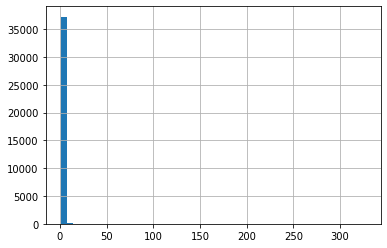

In [9]:
aux['calculated_host_listings_count'].hist(bins=50)

In [13]:
# Top 10 hosts: count and accumulated rate
data.groupby('host_id').size().reset_index(name='count').sort_values(by='count', ascending=False).assign(rate=lambda x: (x['count']/sum(x['count'])*100), accum=lambda x: x['rate'].cumsum()).head(10)

,host_id,count,rate,accum
34646,219517861,327,0.668780,0.668780
29407,107434423,232,0.474486,1.143266
19574,30283594,121,0.247469,1.390735
31079,137358866,103,0.210655,1.601391
14436,16098958,96,0.196339,1.797730
12806,12243051,96,0.196339,1.994069
25662,61391963,91,0.186113,2.180182
17091,22541573,87,0.177932,2.358114
33868,200380610,65,0.132938,2.491052
3044,1475015,52,0.106350,2.597403


Some notes about host_id feature:

- There are 37.457 unique hosts in the dataset. Given that there are 48.895 observations, this means that some hosts have more than one property.
- There are 5.154 hosts in the dataset that have more than one property. This represents 13.8% of total number of hosts.
- This means that the vast majority of hosts have only one property in the site.
- Lookin at the hosts top-10, it can be seen that the host with more properies has 327 of them, which represent 0.66% of the total. The 10 hosts with more properties represent 2.6% of the observations.
- This seems to indicate that the properties included in the dataset are not highly concentrated in a few hosts.    

### Neighbourhood group and neighbourhood

In [27]:
print(f'There are {data["neighbourhood_group"].nunique()} neighbourhood groups (regions) and {data["neighbourhood"].nunique()} neighbourhoods.')

There are 5 neighbourhood groups (regions) and 221 neighbourhoods.


In [6]:
# Function to plot countplots of category variables
def countplot_features(feature, title):
    sns.set_palette("Set2")
    plot=sns.countplot(x=feature,data=data).set(title=title)
    plt.show()


def countplot_targetvsfeature(feature,y,title):
    fig = plt.figure(figsize=(10,5))
    sns.set_palette("Set2")
    plot=sns.countplot(x=feature,data=data,hue=y).set(title=title)
    plt.show()  

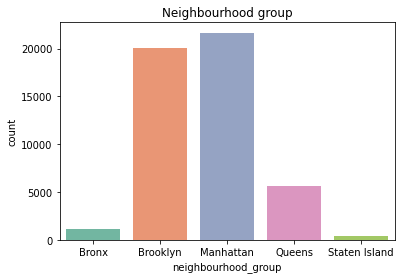

In [7]:
# Neigbourhood groups
countplot_features("neighbourhood_group", "Neighbourhood group")

In [31]:
#Region
data['neighbourhood_group'].value_counts()

Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: neighbourhood_group, dtype: int64

In [30]:
# Neighbourhood
data['neighbourhood'].value_counts()

Williamsburg          3920
Bedford-Stuyvesant    3714
Harlem                2658
Bushwick              2465
Upper West Side       1971
                      ... 
Richmondtown             1
Willowbrook              1
Fort Wadsworth           1
New Dorp                 1
Woodrow                  1
Name: neighbourhood, Length: 221, dtype: int64

In [15]:
# How many neighbourhoods has each region?
pd.pivot_table(data, index='neighbourhood_group', values=['neighbourhood'], aggfunc=lambda x: len(x.unique()))

,neighbourhood
neighbourhood_group,
Bronx,48
Brooklyn,47
Manhattan,32
Queens,51
Staten Island,43


In [16]:
# Top 3 neighbourhoods in each region with more observations

data.groupby(['neighbourhood_group','neighbourhood']).size().to_frame().rename(columns={0: 'Obs'}).sort_values(by=['neighbourhood_group', 'Obs'], ascending=[True, False]).groupby(level=0).head(3)

Obs
neighbourhood_group neighbourhood           
Bronx               Kingsbridge           70
                    Fordham               63
                    Longwood              62
Brooklyn            Williamsburg        3920
                    Bedford-Stuyvesant  3714
                    Bushwick            2465
Manhattan           Harlem              2658
                    Upper West Side     1971
                    Hell's Kitchen      1958
Queens              Astoria              900
                    Long Island City     537
                    Flushing             426
Staten Island       St. George            48
                    Tompkinsville         42
                    Stapleton             27

- By region, the one with most observations is Manhattan, followed very closely by Brooklyn (each of them has 20k observations approximately).
- The neighbourhood with more observations is Williamsburg and the second one is Bedford-Stuyvesant, both of them are located in the region of Brooklyn. The third one is Harlem, located in Manhattan.

### Room type

In [17]:
print(f'There are {data["room_type"].nunique()} different room types.')

There are 3 different room types.


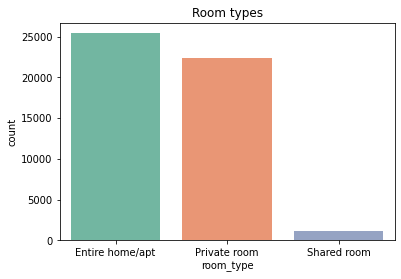

In [18]:
# Room types
countplot_features("room_type", "Room types")

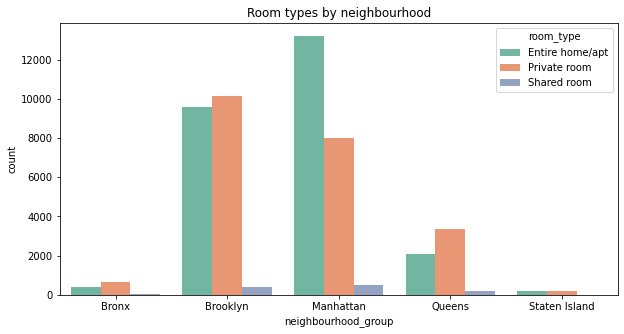

In [8]:
# Room types by neighbourhood

countplot_targetvsfeature("neighbourhood_group","room_type","Room types by neighbourhood")

- Most observations correspond to entire homes or apartments and private rooms.
- In Manhattan, most observations correspond to entire home/apt.
- In Brooklyn, Queens and Bronx most observations correspond to private rooms.
- In Staten Island there is a similar amount of entire home/apt and private rooms.

### Price

In [16]:
# Distribution of price
# Box plot
fig = px.box(data, y="price")
fig.show()

In [12]:
# Distribution of price
# Histogram
fig = px.histogram(data, 'price')
fig.show()

In [16]:
# Histogram of prices until the upper fence (q3 + 1.5*IQR)
# The extreme values are not removed from the database, this is only for visualization

fig = px.histogram(data.loc[data['price']<=334,'price'], 'price', nbins=20)
fig.show()

In [15]:
print('Number of observations with price equal to zero:',len(data[data['price']==0]))

Number of observations with price equal to zero: 0


In [10]:
# since there are only 11 observations with price=0, we decide to remove this observations

data = data[data['price']!=0]

- The price feature has many extreme values, until 10k. This variable is positively skewed.
- Searching the airbnb website we can see that there are hotels/apartments with these prices, so a priori there is no reason to belive that these values are incorrect.
- There are observations with price=0, that is strange. There are 11 observations with price=0. Since this are ver few observations, this are removed from the database.

In [19]:
data['price'].describe()

count    48884.000000
mean       152.755053
std        240.170260
min         10.000000
25%         69.000000
50%        106.000000
75%        175.000000
max      10000.000000
Name: price, dtype: float64

- After removing the obs with price=0, the 25% lower prices are between 10 and 69
- It is interesting to see if there are observations with suspiciously low prices, since this colud be not real prices 

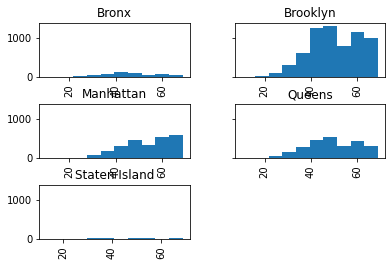

In [20]:
data[data['price']<=69]['price'].hist(by=data['neighbourhood_group'], sharey=True)
plt.show()

In [21]:
data.groupby('neighbourhood_group')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group,,,,,,,,
Bronx,1090.0,87.577064,106.725371,10.0,45.0,65.0,99.0,2500.0
Brooklyn,20095.0,124.438915,186.896837,10.0,60.0,90.0,150.0,10000.0
Manhattan,21660.0,196.884903,291.386838,10.0,95.0,150.0,220.0,10000.0
Queens,5666.0,99.517649,167.102155,10.0,50.0,75.0,110.0,10000.0
Staten Island,373.0,114.812332,277.620403,13.0,50.0,75.0,110.0,5000.0


In [11]:
data.groupby('room_type')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
room_type,,,,,,,,
Entire home/apt,25407.0,211.810918,284.046575,10.0,120.0,160.0,229.0,10000.0
Private room,22319.0,89.809131,160.222493,10.0,50.0,70.0,95.0,10000.0
Shared room,1158.0,70.248705,101.771306,10.0,33.0,45.0,75.0,1800.0


In [12]:
len(data[data['price']<20])

43

- In all regions, except Staten Island, the minimun price is 10. By room type, the minimum in the three of them is zero. This is a suspiciously low price but more information from the database owner is needed to remove this values.
- There are only 43 observations in the database with price lower than 20. Even if they are incorrect prices, they will not do a huge harm as this are few observations compared to the total. For now they will not be removed.

In [63]:
# Price by type of room
fig = px.box(data, x="price", y="room_type")
fig.show()

<AxesSubplot:title={'center':'Median price'}, xlabel='room_type'>

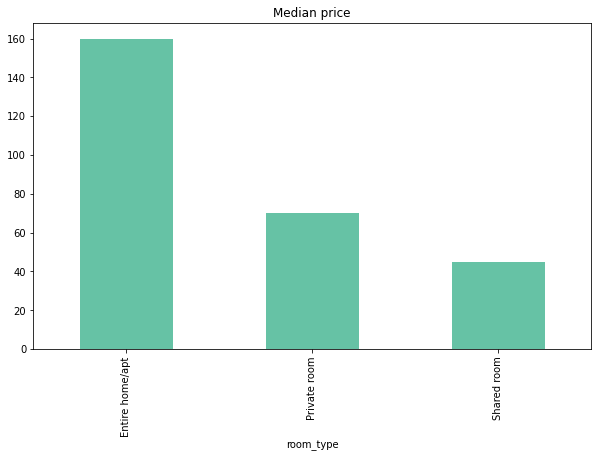

In [13]:
# Median price by room_type
data_groups = data.groupby(['room_type'])['price'].median()

data_groups.plot(kind='bar', title='Median price',
                xlabel='room_type', figsize=(10, 6))

- The maximum price of shared room is lower than for entire home/apt and private room, whis makes sense.
- In median, the entire home/apt is the most expensive, followed by private room and shared room

In [64]:
# Price by region
fig = px.box(data, x="price", y="neighbourhood_group")
fig.show()

<AxesSubplot:title={'center':'Median price'}, xlabel='Neighbourhood group'>

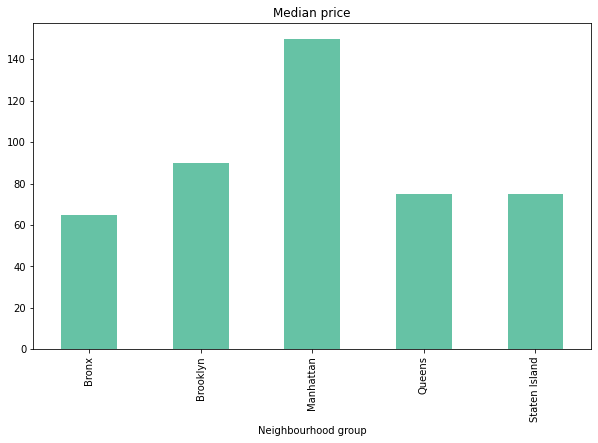

In [65]:
# Median price by neighbourhood group
data_groups = data.groupby(['neighbourhood_group'])['price'].median()

data_groups.plot(kind='bar', title='Median price',
                xlabel='Neighbourhood group', figsize=(10, 6))

- Bronx and Staten Island are the regions with lowest maximum values.
- In median, Manhattan has the highest prices, followed by Brooklyn. Bronx, Queens and Staten Island have similar median prices.

In [15]:
# Mean and median of prices by room_type in each region

data.groupby(['neighbourhood_group', 'room_type'])['price'].agg(['mean', 'median'])

mean  median
neighbourhood_group room_type                          
Bronx               Entire home/apt  127.506596   100.0
                    Private room      66.890937    54.0
                    Shared room       59.800000    40.0
Brooklyn            Entire home/apt  178.346202   145.0
                    Private room      76.545428    65.0
                    Shared room       50.773723    36.0
Manhattan           Entire home/apt  249.257994   191.0
                    Private room     116.776622    90.0
                    Shared room       88.977083    69.0
Queens              Entire home/apt  147.050573   120.0
                    Private room      71.762456    60.0
                    Shared room       69.020202    37.0
Staten Island       Entire home/apt  173.846591   100.0
                    Private room      62.292553    50.0
                    Shared room       57.444444    30.0

- In the 5 regions the most expensive room type is the entire home/apt, followed by the private room and in thir place the shared room.
- In median and mean, the three room types are most expensive in Manhattan than in the other regions.

### Number of reviews

In [45]:
# Number of reviews by neighbourhood group
fig = px.box(data, x="number_of_reviews", y="neighbourhood_group")
fig.show()

In [25]:
# ver reviews por mes y año para el total y por zona

data['last_review_2'] = data['last_review'].dt.to_period('M')


### Availability_365

This feature measures the availability of the property (in days) in the next 365 days. 

In [46]:
# Availability_365 by neighbourhood group

fig = px.box(data, x="availability_365", y="neighbourhood_group")
fig.show()

- The neighbourhood groups with higher median availability in the next 365 days are Bronx and Staten Island.
- Manhattan and Brooklyn are the neighbourhood groups with lower median availability in the next 365 days. This could be indicating that this are the most demanded regions (they have the lower availabiltiy and the higher prices).

### Correlation between selected variables: heatmap

<AxesSubplot:>

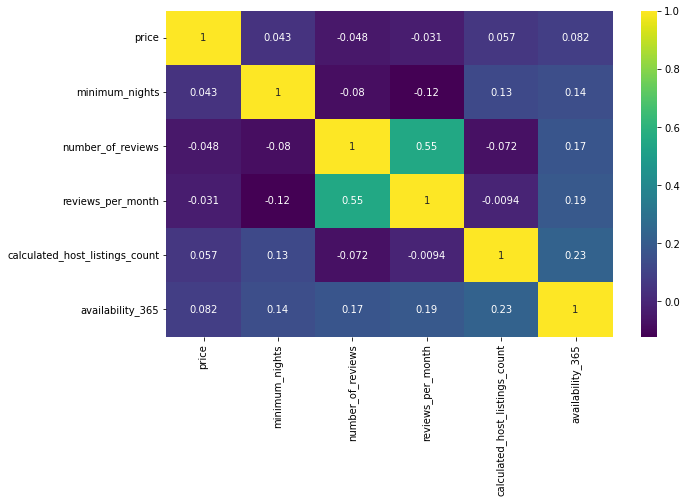

In [12]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[['price','minimum_nights','number_of_reviews','reviews_per_month','calculated_host_listings_count','availability_365']].corr(), annot=True, cmap='viridis')

- Correlations between features are very low except for reviews per month and number of reviews which is reasonable

### Latitude and longitude

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='longitude', ylabel='latitude'>

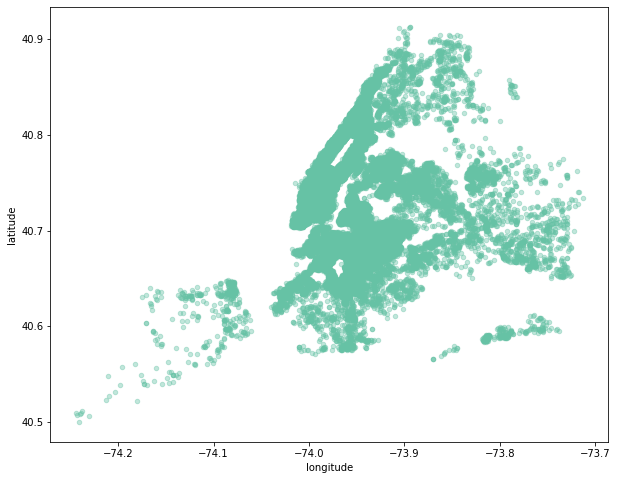

In [68]:
# Scatter plot of latitude and longitude to see if there are strange values


fig=data.plot(kind='scatter', x='longitude', y='latitude',
                  alpha=0.4, figsize=(10,8))
fig

 

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

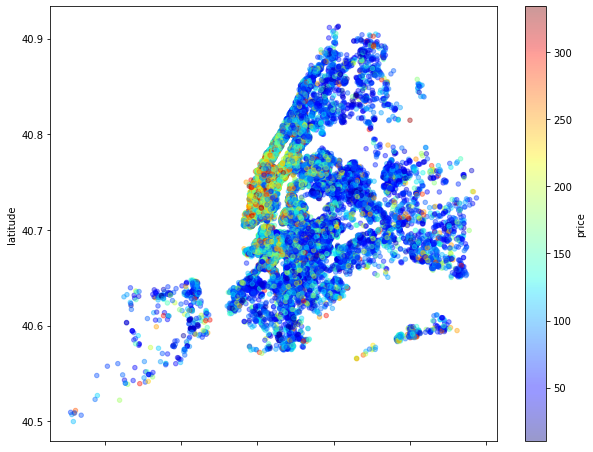

In [17]:
# The same scatter plot but adding the price feature
# Only observations with price < 335 are included in order to improve the visualization
# The upper bound for suspected outliers is 334 (using the method of IQR)

fig=data[data['price']<335].plot(kind='scatter', x='longitude', y='latitude', c='price',
                  cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4, figsize=(10,8))
fig



In [18]:
# Map with plotly express

fig=px.scatter_mapbox(data[data['price']<335],lat='latitude', lon='longitude', mapbox_style='open-street-map',  color='price', width=700, height=700)
fig.show()


- In the scatter plot and the map, we can see that the observations with higher prices are located in Manhattan and Brooklyn.